## Notebook setup

In [1]:
from itertools import chain
from itertools import product
import numpy as np
import anndata as ad
import pandas as pd
import scanpy as sc
import scanpy.external as sce
# import scvelo as scv
# import cellrank as cr
import harmonypy as harmony
import seaborn as sns
from scipy import io
from scipy import sparse


In [2]:
import gc
gc.enable()

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(
    dpi_save=400, dpi=200, 
    transparent=True, 
    color_map="viridis"
)

scanpy==1.8.1 anndata==0.7.6 umap==0.5.1 numpy==1.21.2 scipy==1.7.1 pandas==1.3.2 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 pynndescent==0.5.4


In [3]:
import os
os.chdir('/local/workdir/dwm269/ma_ipsc/')

In [4]:
# Load metadata
meta = pd.read_csv("resources/metadata_v1.csv")
print(meta)

              sample                                           data.dir  \
0                 D0  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
1                 D1  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
2                 D4  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
3                 D6  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
4                 D8  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
5                D12  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
6                D21  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
7    D4_SmallPattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
8    D4_LargePattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
9   D21_SmallPattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   
10  D21_LargePattern  /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...   

   patterm  pattern_int timepoint  time_int  
0    600um          600        D0         0  
1    60

In [36]:
print(meta["data.dir"][1])

/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D1_STARsolo


In [122]:
# Load in count mats, initialize adata object(s)
adata_list = []
for i in range(0,meta.shape[0]):
    print("Sample: " + meta["sample"][i])
    
    adata_list.append(
        sc.read_10x_mtx(
            path=meta["data.dir"][i]+"/Solo.out/GeneFull/filtered",  # the directory with the `.mtx` file
            var_names='gene_symbols',
            make_unique=True,
            cache=True # write a cache file for faster subsequent reading
        )
    )    
    adata_list[i].var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
    
    adata_list[i].layers['counts'] = adata_list[i].X # save counts as a layer for future plotting
    
    print("     Loaded " + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) + " genes...")

Sample: D0
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D0_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 10693 cells and 67049 genes...
Sample: D1
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D1_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 10956 cells and 67049 genes...
Sample: D4
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D4_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 8908 cells and 67049 genes...
Sample: D6
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D6_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 7524 cells and 67049 genes...
Sample: D8
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D8_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 10679 cells and 67049 genes...
Sample: D12
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D12_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 7055 cells and 67049 genes...
Sample: D21
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D21_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 13372 cells and 67049 genes...
Sample: D4_SmallPattern
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D4_SmallPattern_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 7780 cells and 67049 genes...
Sample: D4_LargePattern
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D4_LargePattern_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 11007 cells and 67049 genes...
Sample: D21_SmallPattern
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D21_SmallPattern_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 11007 cells and 67049 genes...
Sample: D21_LargePattern
... reading from cache file cache/workdir-dwm269-ma_ipsc-data-STARsolo-GRCh38p13-D21_LargePattern_STARsolo-Solo.out-GeneFull-filtered-matrix.h5ad


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 24195 cells and 67049 genes...


In [123]:
# Load in spliced/unspliced/ambiguous matrices

for i in range(0,meta.shape[0]): #samples
    path = meta["data.dir"][i]+"/Solo.out/Velocyto/filtered/"
    print("Loading splice mats from " + path)
    
    # Get intersection of cells in GeneFull and Velocyto mats
    cells_velocyto = pd.read_csv(path+"barcodes.tsv.gz", delimiter = '\t',header=None).iloc()[:,0].values.tolist()
    cells_genefull = adata_list[i].obs_names
    cells_intersect = list(set(cells_velocyto) & set(cells_genefull))
    
    print("    "+ str(len(cells_genefull) - len(cells_velocyto)) + " cells not found in Velocyto matrices...")
    adata_list[i] = adata_list[i][adata_list[i].obs_names.isin(cells_intersect), :] #subset out cells not found in Velocyto mats
    
    print("    AnnData object now has "+ str(adata_list[i].shape[0]) + " cells.")
    
    # Add Velocyto matrices as layers    
    tmp_cells = list(chain(*pd.DataFrame(cells_velocyto).isin(cells_intersect).values.tolist()))
    
    spliced = sparse.csr_matrix(io.mmread(path+'spliced.mtx.gz')).transpose()        
    adata_list[i].layers['spliced'] = spliced[tmp_cells, :]
    
    unspliced = sparse.csr_matrix(io.mmread(path+'unspliced.mtx.gz')).transpose() 
    adata_list[i].layers['unspliced'] = unspliced[tmp_cells, :]
    
    ambiguous = sparse.csr_matrix(io.mmread(path+'ambiguous.mtx.gz')).transpose()
    adata_list[i].layers['ambiguous'] = ambiguous[tmp_cells, :]

Loading splice mats from /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D0_STARsolo/Solo.out/Velocyto/filtered/
    241 cells not found in Velocyto matrices...
    AnnData object now has 10435 cells.
Loading splice mats from /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D1_STARsolo/Solo.out/Velocyto/filtered/
    49 cells not found in Velocyto matrices...
    AnnData object now has 10879 cells.
Loading splice mats from /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D4_STARsolo/Solo.out/Velocyto/filtered/
    197 cells not found in Velocyto matrices...
    AnnData object now has 8609 cells.
Loading splice mats from /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D6_STARsolo/Solo.out/Velocyto/filtered/
    232 cells not found in Velocyto matrices...
    AnnData object now has 7202 cells.
Loading splice mats from /workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p13/D8_STARsolo/Solo.out/Velocyto/filtered/
    122 cells not found in Velocyto matrices...
    AnnData object now has 10546 cells

## Filter and preprocess individual datasets

In [124]:
print(adata_list[1].layers)

print(adata_list[1].shape)

Layers with keys: counts, spliced, unspliced, ambiguous
(10879, 67049)


normalizing counts per cell
    finished (0:00:00)


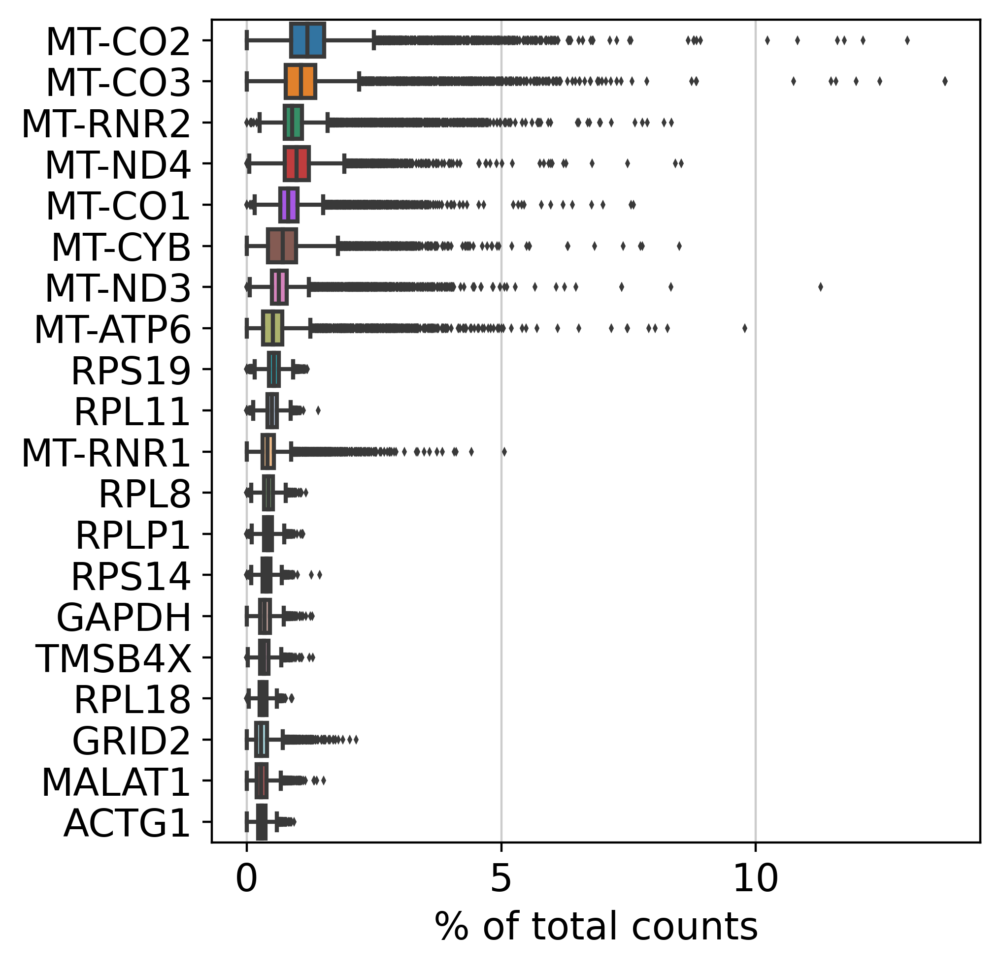

normalizing counts per cell
    finished (0:00:00)


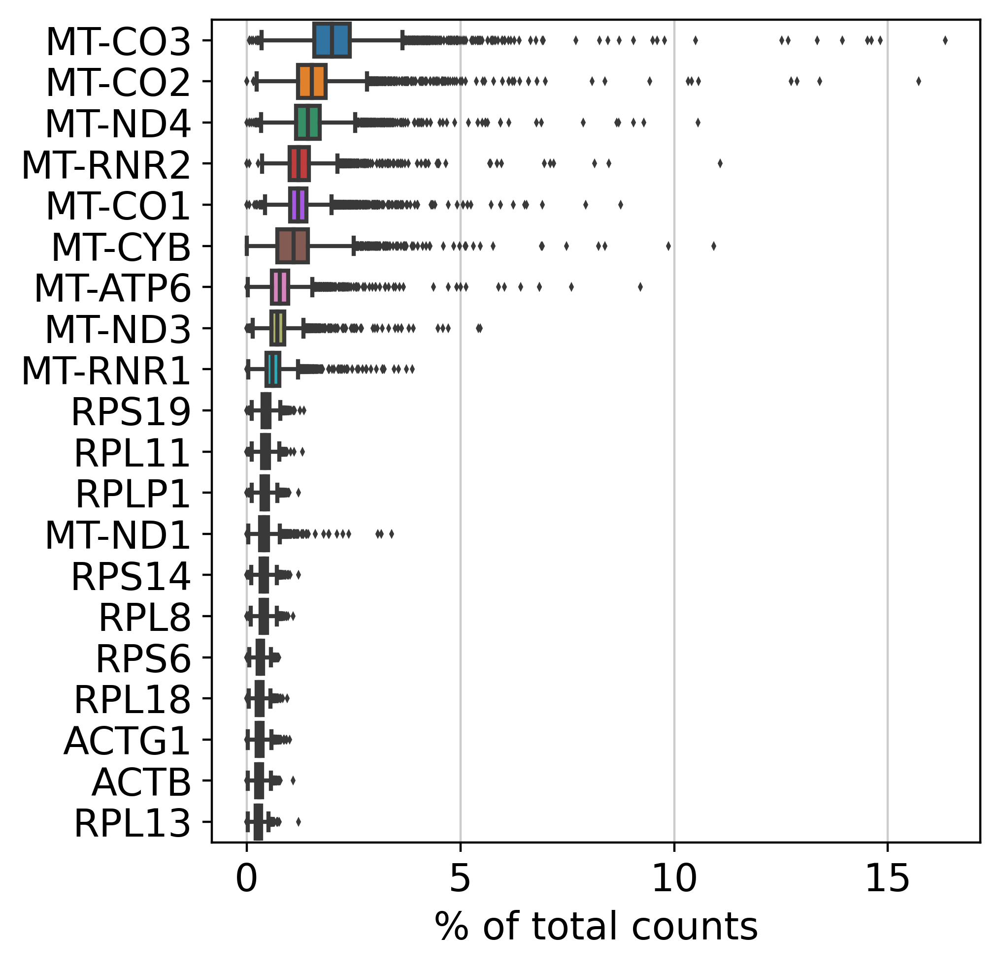

normalizing counts per cell
    finished (0:00:00)


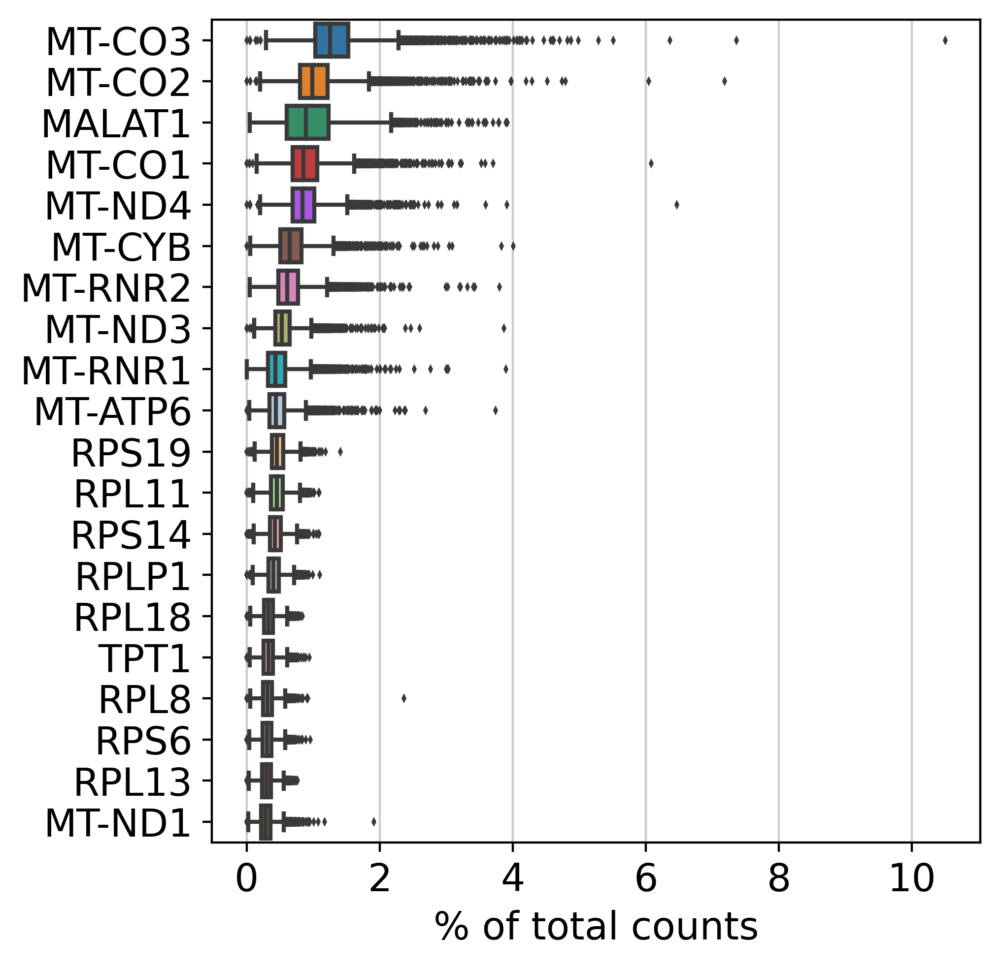

normalizing counts per cell
    finished (0:00:00)


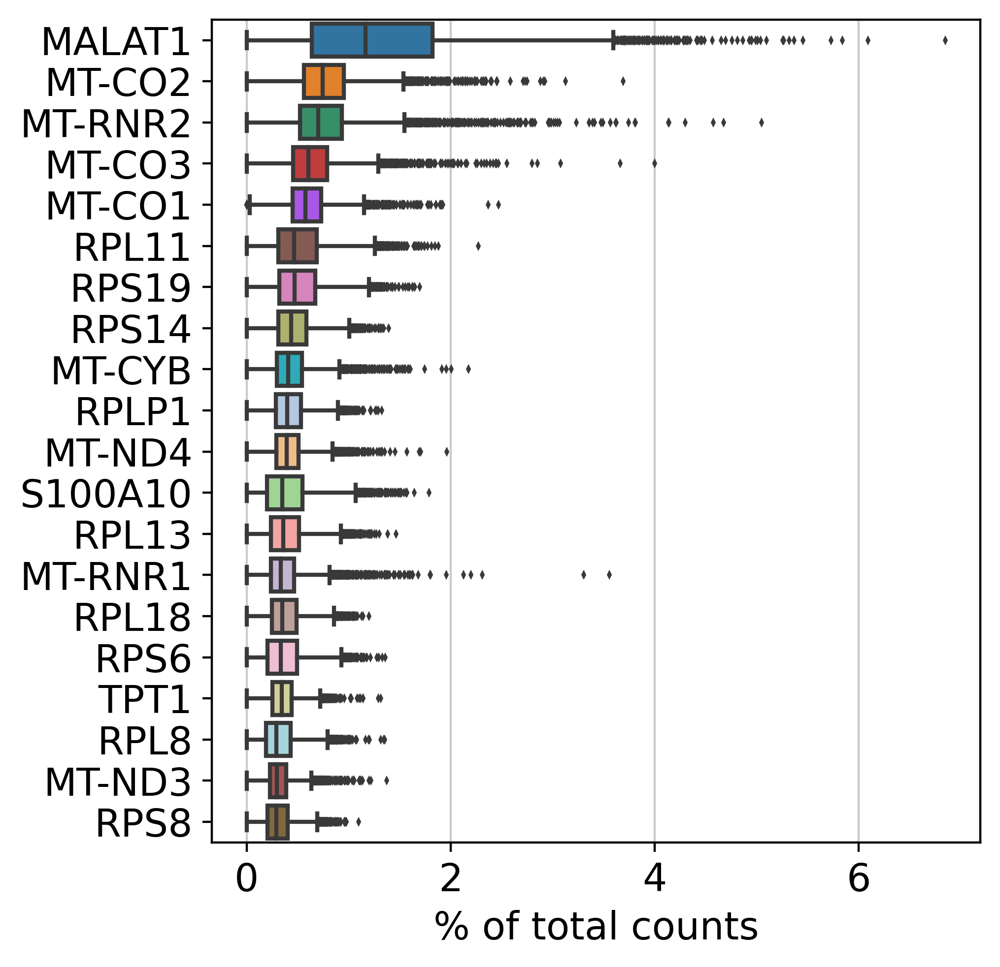

normalizing counts per cell
    finished (0:00:00)


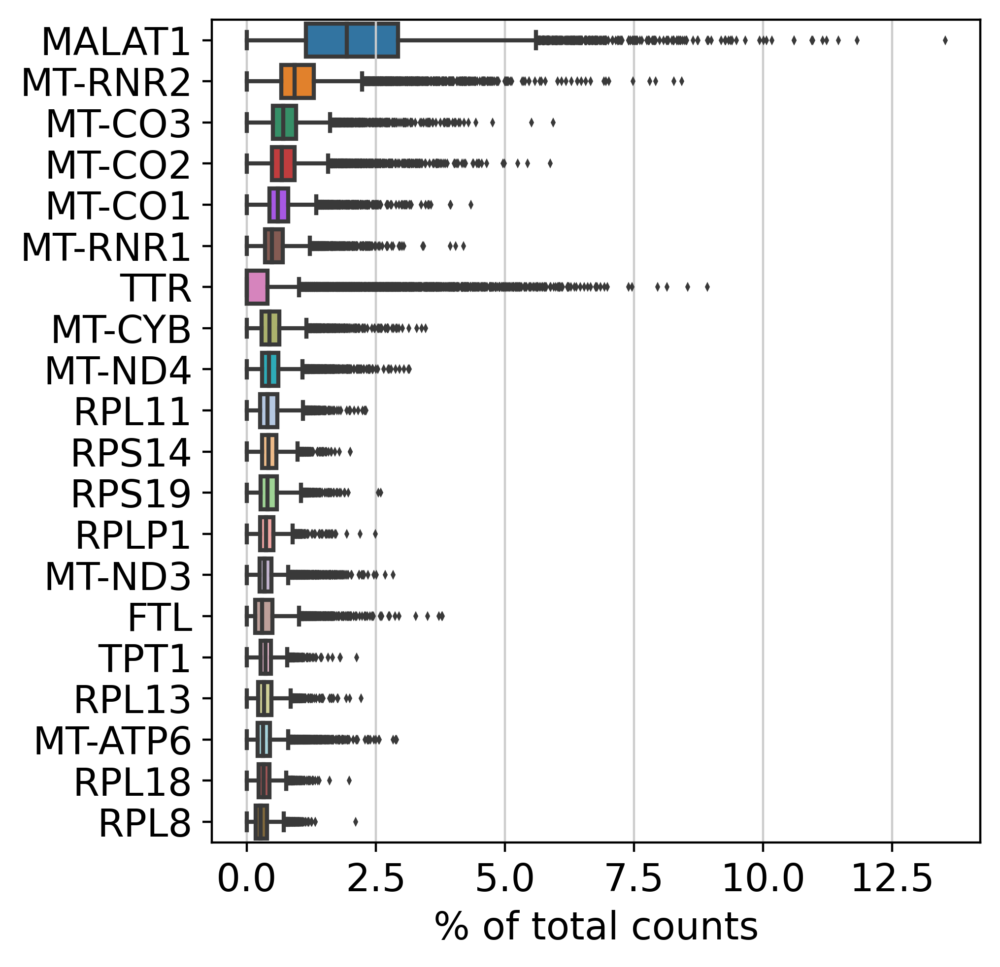

normalizing counts per cell
    finished (0:00:00)


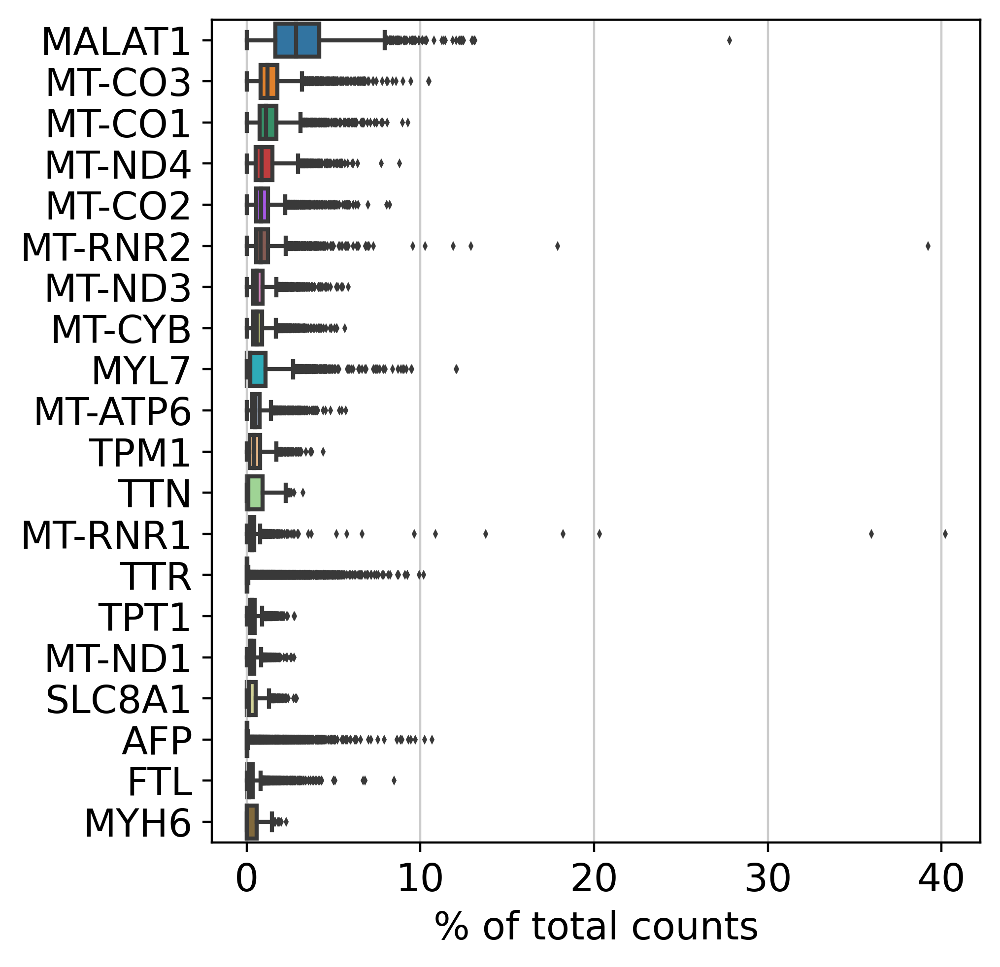

normalizing counts per cell
    finished (0:00:00)


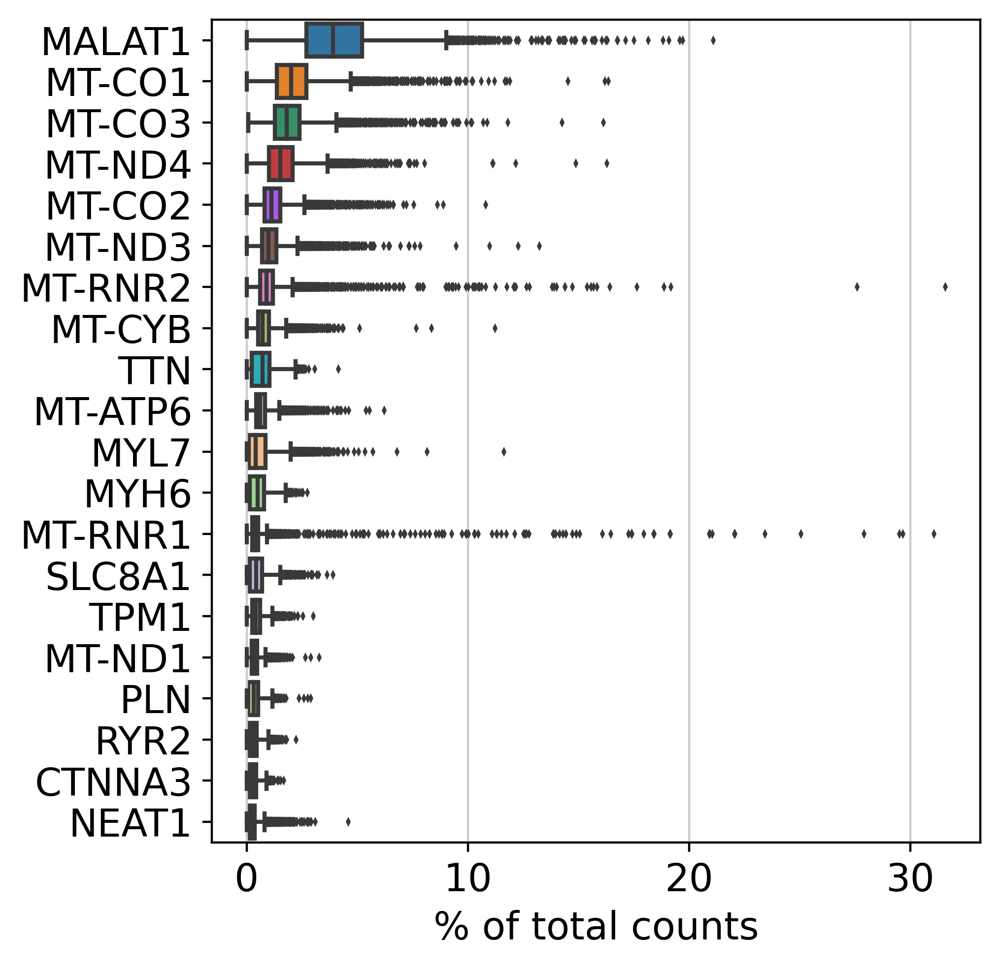

normalizing counts per cell
    finished (0:00:00)


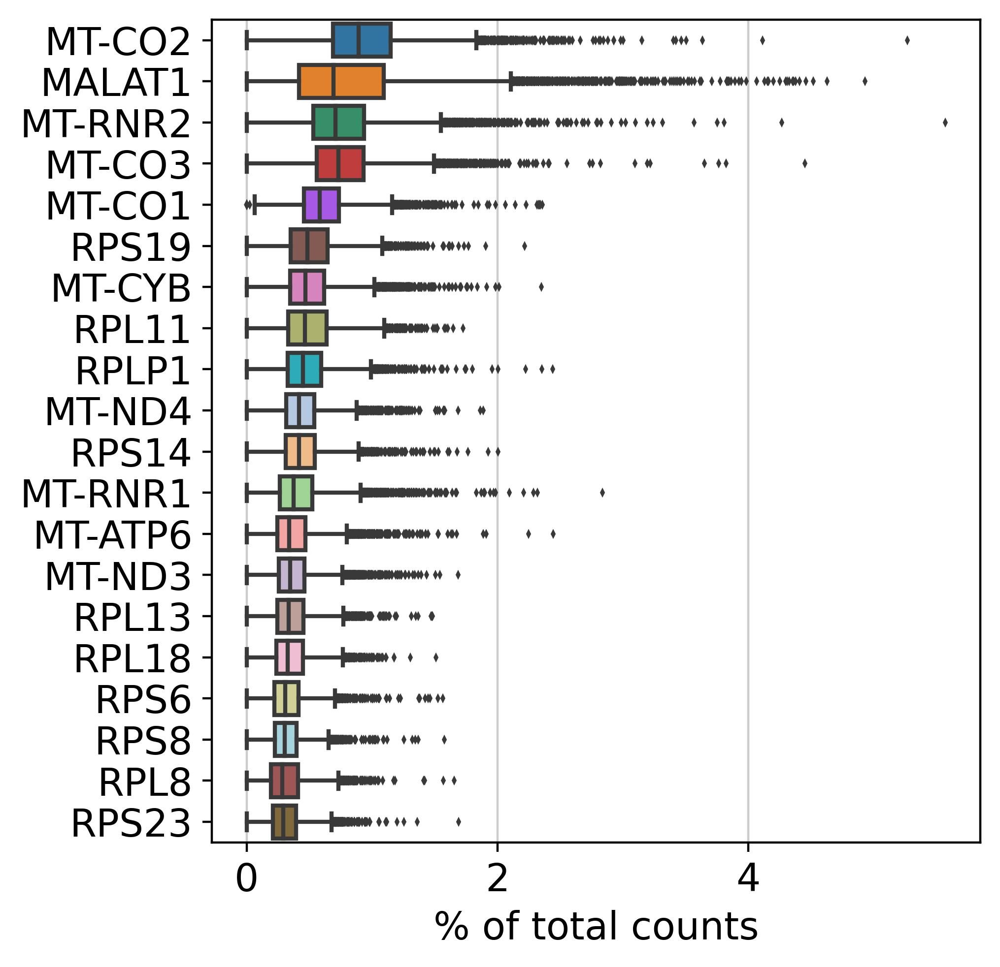

normalizing counts per cell
    finished (0:00:00)


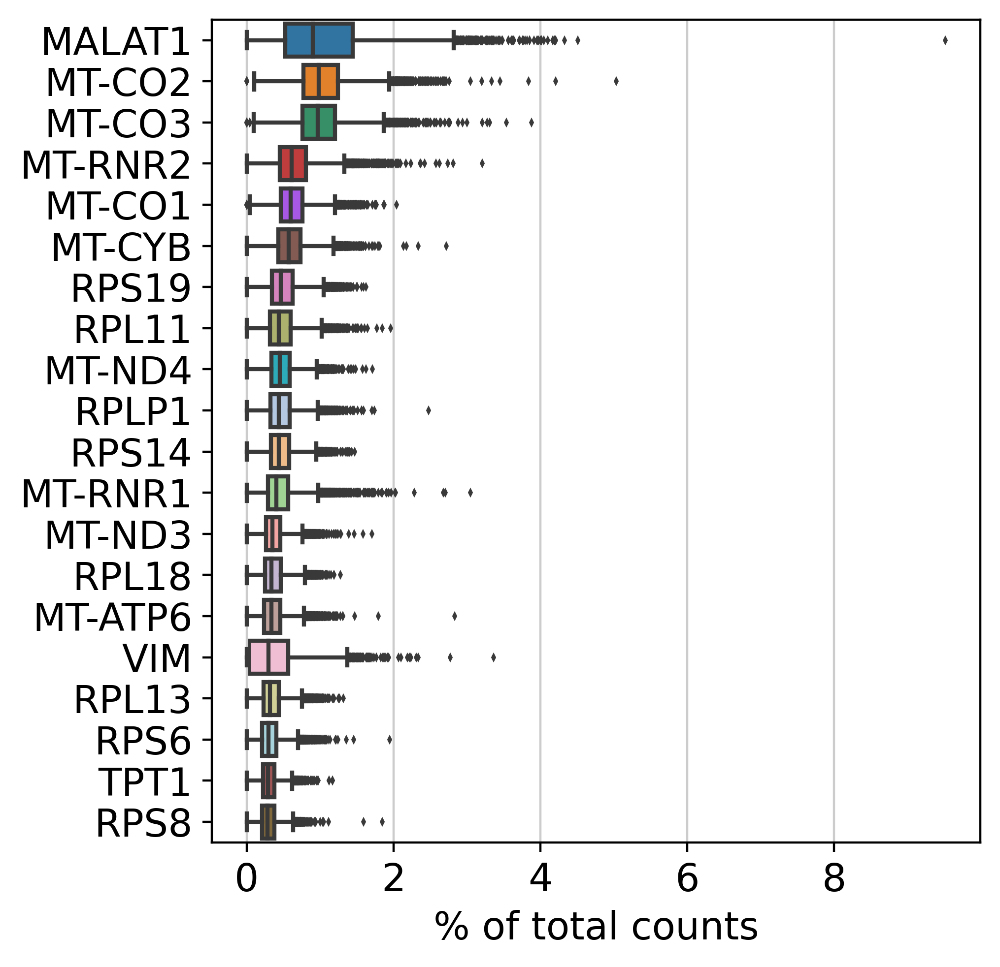

normalizing counts per cell
    finished (0:00:00)


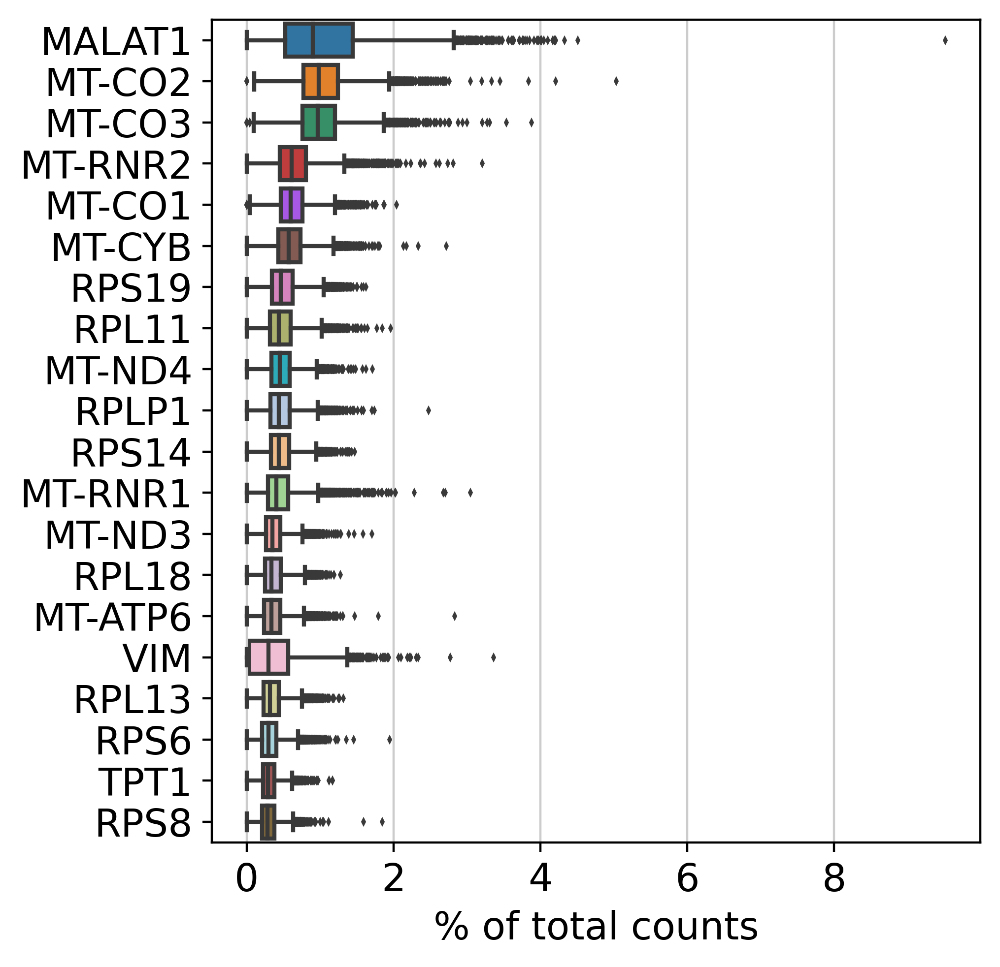

normalizing counts per cell
    finished (0:00:01)


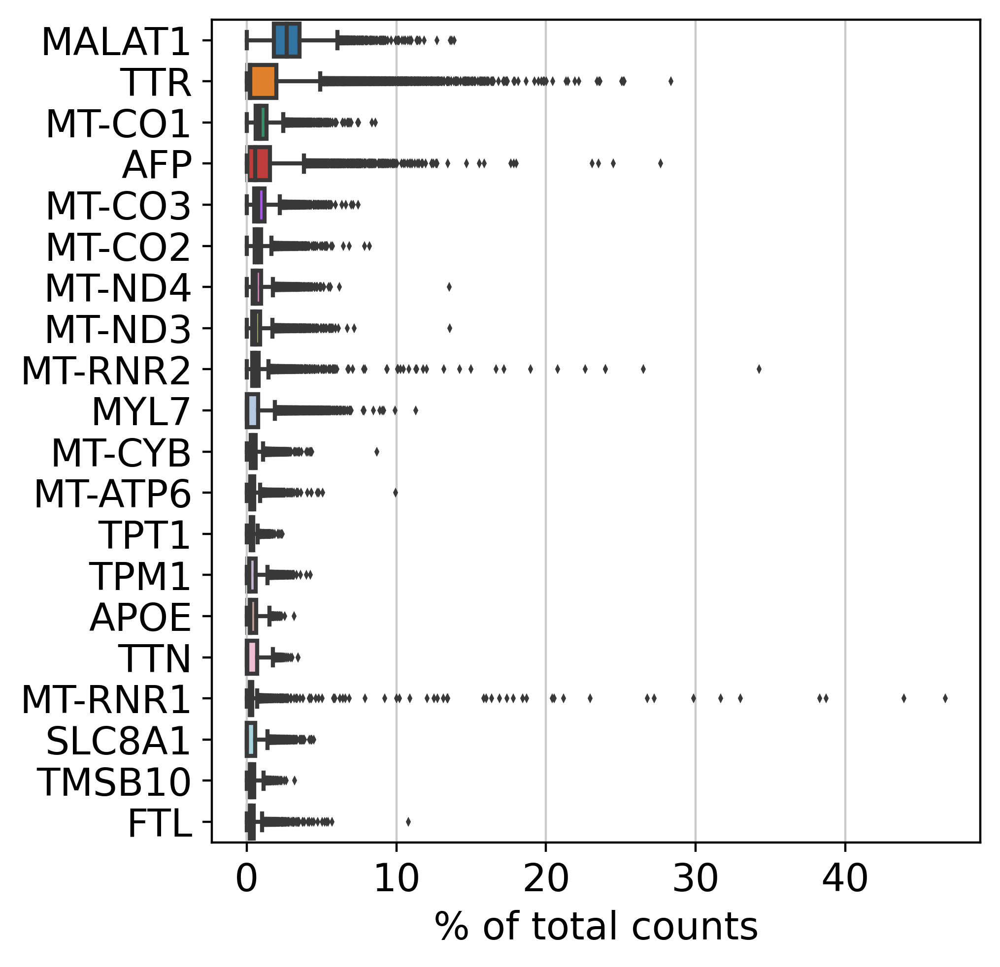

In [59]:
sc.set_figure_params(
    figsize=(3,3),
    dpi=200
)
for i in range(0,meta.shape[0]):
    sc.pl.highest_expr_genes(adata_list[i], n_top=20, )

In [125]:
# gene/transcript, mito filters count filters
for i in range(0,meta.shape[0]):
    print(meta["sample"][i] + ': ' + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) +' features...')  
    
    # Hard filters for feature and UMI counts
    sc.pp.filter_cells(
        adata_list[i],
        min_genes=1000
    )
    sc.pp.filter_cells(
        adata_list[i], 
        min_counts=1000
    )
    sc.pp.filter_cells(
        adata_list[i], 
        max_counts=25000
    )
    
    # Hard filter for sparsely detected features
    sc.pp.filter_genes(
        adata_list[i],
        min_cells=1
    ) 
        
    adata_list[i].var['mito'] = adata_list[i].var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata_list[i], 
        qc_vars=['mito'], 
        percent_top=None, 
        log1p=False, 
        inplace=True
    )  
    
    # QC filter(s)
    adata_list[i] = adata_list[i][adata_list[i].obs.pct_counts_mito < 15, :] # less than 15% mito 
    print(" ")


D0: 10435 cells and 67049 features...
filtered out 502 cells that have less than 1000 genes expressed
filtered out 29296 genes that are detected in less than 1 cells
 
D1: 10879 cells and 67049 features...
filtered out 34 cells that have less than 1000 genes expressed
filtered out 29110 genes that are detected in less than 1 cells
 
D4: 8609 cells and 67049 features...
filtered out 1 cells that have less than 1000 genes expressed
filtered out 4 cells that have more than 25000 counts
filtered out 29082 genes that are detected in less than 1 cells
 
D6: 7202 cells and 67049 features...
filtered out 65 cells that have less than 1000 genes expressed
filtered out 31 cells that have more than 25000 counts
filtered out 28071 genes that are detected in less than 1 cells
 
D8: 10546 cells and 67049 features...
filtered out 539 cells that have less than 1000 genes expressed
filtered out 17 cells that have more than 25000 counts
filtered out 27394 genes that are detected in less than 1 cells
 
D1

In [126]:
# Add metadata to each anndata object
for i in range(0,meta.shape[0]): #samples
    for j in range(0,meta.shape[1]): #metadata features
        adata_list[i].obs[meta.columns[j]] = meta.iloc[i,j]

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


Running Scrublet
filtered out 6502 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.2%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 11.1%
    Scrublet finished (0:00:47)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


filtered out 6780 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:35)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.5%
    Scrublet finished (0:01:14)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


filtered out 6407 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%
    Scrublet finished (0:00:37)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


filtered out 6500 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.22
Detected doublet rate = 2.7%
Estimated detectable doublet fraction = 41.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 6.6%
    Scrublet finished (0:00:29)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


filtered out 6260 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.18
Detected doublet rate = 4.9%
Estimated detectable doublet fraction = 59.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 8.3%
    Scrublet finished (0:00:42)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6506 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.22
Detected doublet rate = 2.4%
Estimated detectable doublet fraction = 61.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.9%
    Scrublet finished (0:00:23)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6980 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.63
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 1.3%
    Scrublet finished (0:00:34)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6424 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 3.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%
    Scrublet finished (0:00:34)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6466 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.0%
    Scrublet finished (0:00:35)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6466 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.0%
    Scrublet finished (0:00:35)
Running Scrublet


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

filtered out 6000 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:05)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.15
Detected doublet rate = 8.6%
Estimated detectable doublet fraction = 63.7%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 13.5%
    Scrublet finished (0:01:38)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

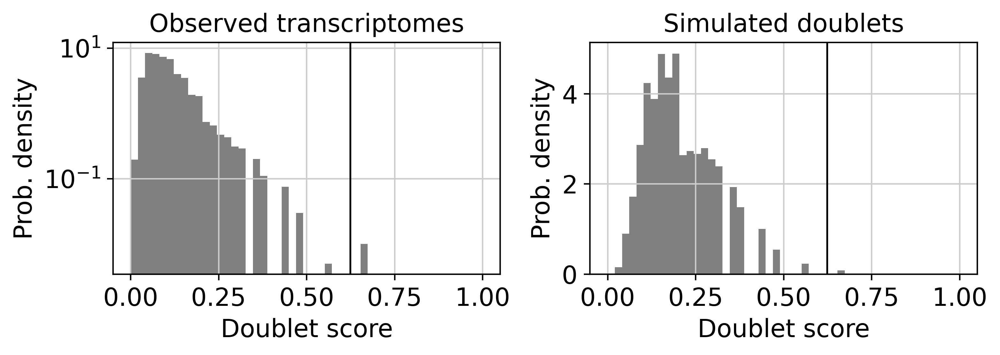

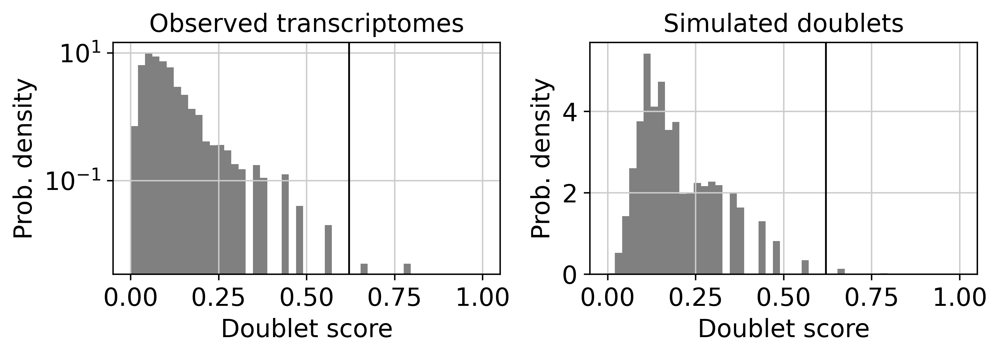

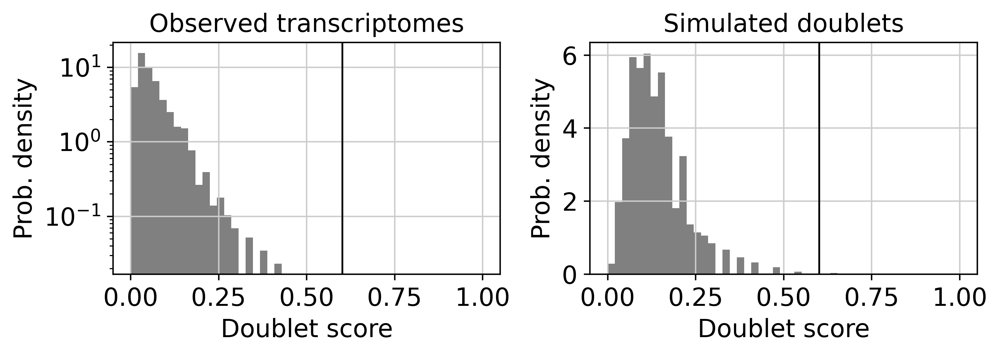

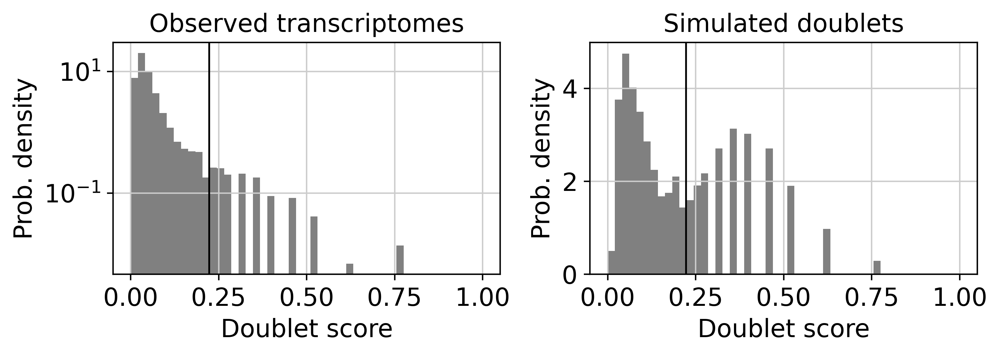

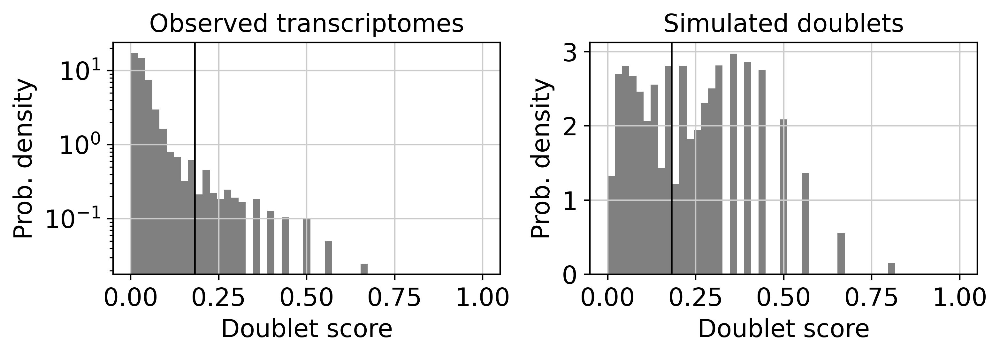

...

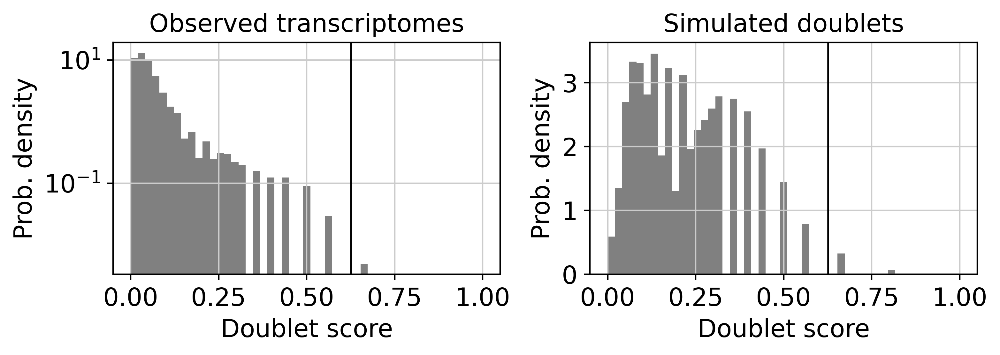

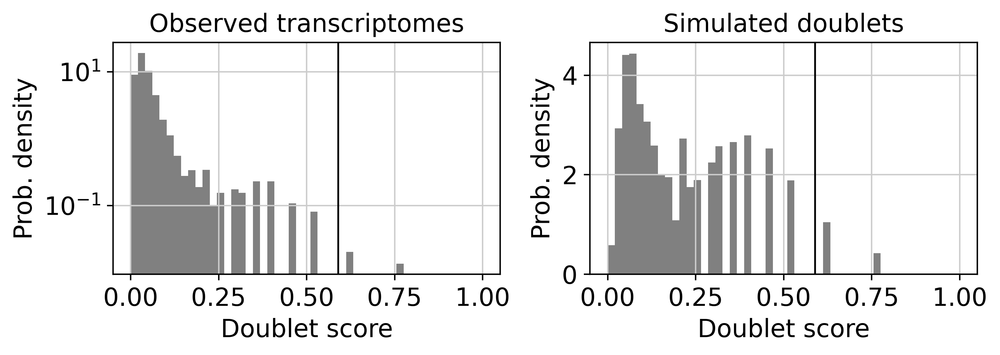

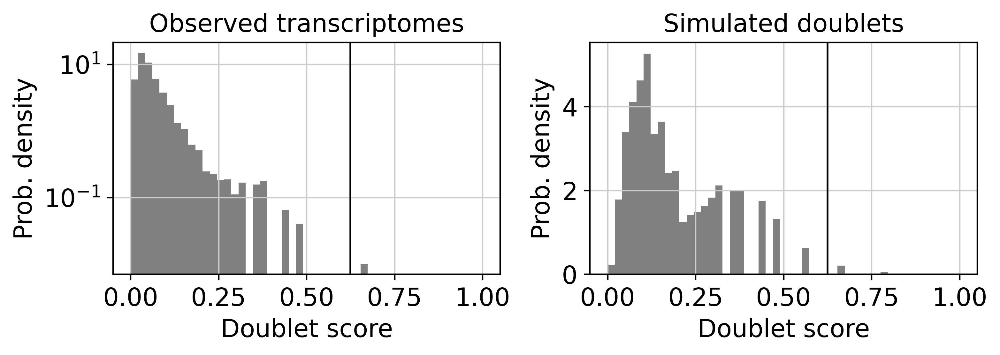

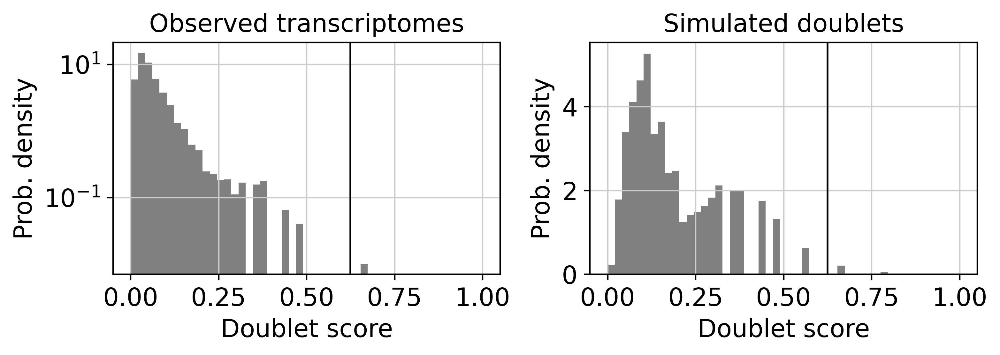

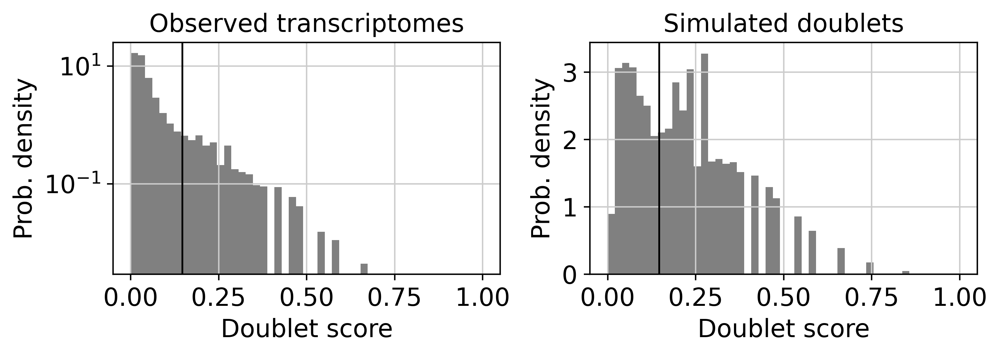

In [127]:
# Doublet removal via Scrublet
## Estimate doublet scores
for i in range(0,meta.shape[0]):
    sc.external.pp.scrublet(
        adata_list[i]
    )
    sc.external.pl.scrublet_score_distribution(
        adata_list[i]
    )

In [128]:
## Doublet score cutoff values for each sample
cutoff_threshold = [0.3, 0.3, 0.3, 0.25, 0.2, 0.2, 0.25, 0.25, 0.2, 0.25, 0.25]

## Remove doublets
for i in range(0,meta.shape[0]):    
    adata_list[i] = adata_list[i][adata_list[i].obs["doublet_score"] < cutoff_threshold[i],]

### Merged analysis

In [142]:
## Merge individual samples for integrated analysis
adata = adata_list[0].concatenate(
    adata_list[1:],
    index_unique=None
#     join="inner"
#     batch_key="sample",
#     batch_categories=meta["sample"]
)

print(adata.shape)

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


(106488, 31146)


In [143]:
adata.obs_names_make_unique()
adata.obs

,n_genes,n_counts,n_genes_by_counts,total_counts,total_counts_mito,pct_counts_mito,sample,data.dir,patterm,pattern_int,timepoint,time_int,doublet_score,predicted_doublet,batch
AAACCCAAGTGCAACG,4187,9578.0,4187,9578.0,777.0,8.112340,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,D0,0,0.131880,False,0
AAACCCAAGTTGGAGC,3822,8510.0,3822,8510.0,766.0,9.001175,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,D0,0,0.202399,False,0
AAACCCACATACCAGT,3936,8730.0,3936,8730.0,749.0,8.579610,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,D0,0,0.091049,False,0
AAACCCACATAGAGGC,3084,5939.0,3084,5939.0,498.0,8.385250,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,D0,0,0.052468,False,0
AAACCCAGTGCAACAG,2197,3992.0,2197,3992.0,327.0,8.191383,D0,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,600um,600,D0,0,0.152582,False,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCAGACCTA,1595,2640.0,1595,2640.0,157.0,5.946970,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,D21,21,0.013864,False,10
TTTGTTGTCCAGTGTA,1942,3361.0,1942,3361.0,132.0,3.927402,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,D21,21,0.012065,False,10
TTTGTTGTCGTGCTCT,1607,2561.0,1607,2561.0,162.0,6.325654,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,D21,21,0.047836,False,10
TTTGTTGTCTACTGAG,4029,8918.0,4029,8918.0,286.0,3.206997,D21_LargePattern,/workdir/dwm269/ma_ipsc/data/STARsolo/GRCh38p1...,1000um,1000,D21,21,0.064337,False,10


In [144]:
## Preprocess merged object
sc.pp.normalize_total(
    adata, 
    target_sum=1e4
)

sc.pp.log1p(
    adata
)

sc.pp.highly_variable_genes(
    adata,
    subset=False
)

adata.raw = adata

normalizing counts per cell
    finished (0:00:02)
extracting highly variable genes
    finished (0:00:25)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


... storing 'sample' as categorical
... storing 'data.dir' as categorical
... storing 'patterm' as categorical
... storing 'timepoint' as categorical
... storing 'feature_types' as categorical
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


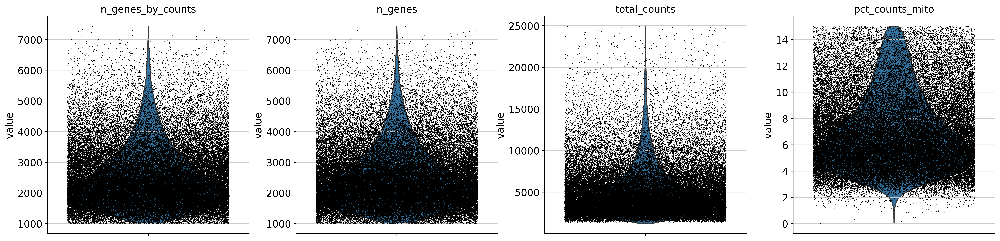

In [145]:
sc.pl.violin(
    adata, 
    ['n_genes_by_counts','n_genes', 'total_counts', 'pct_counts_mito'],
    jitter=0.4, 
    multi_panel=True
)

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GU

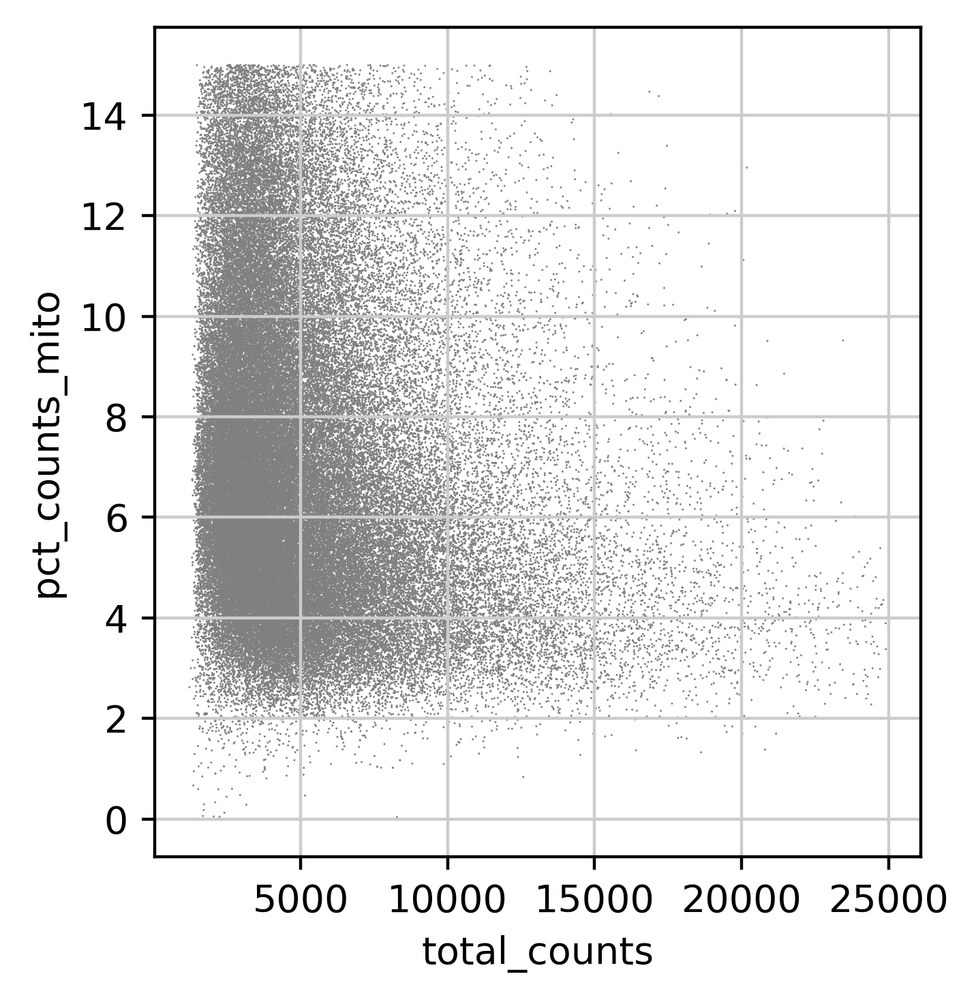

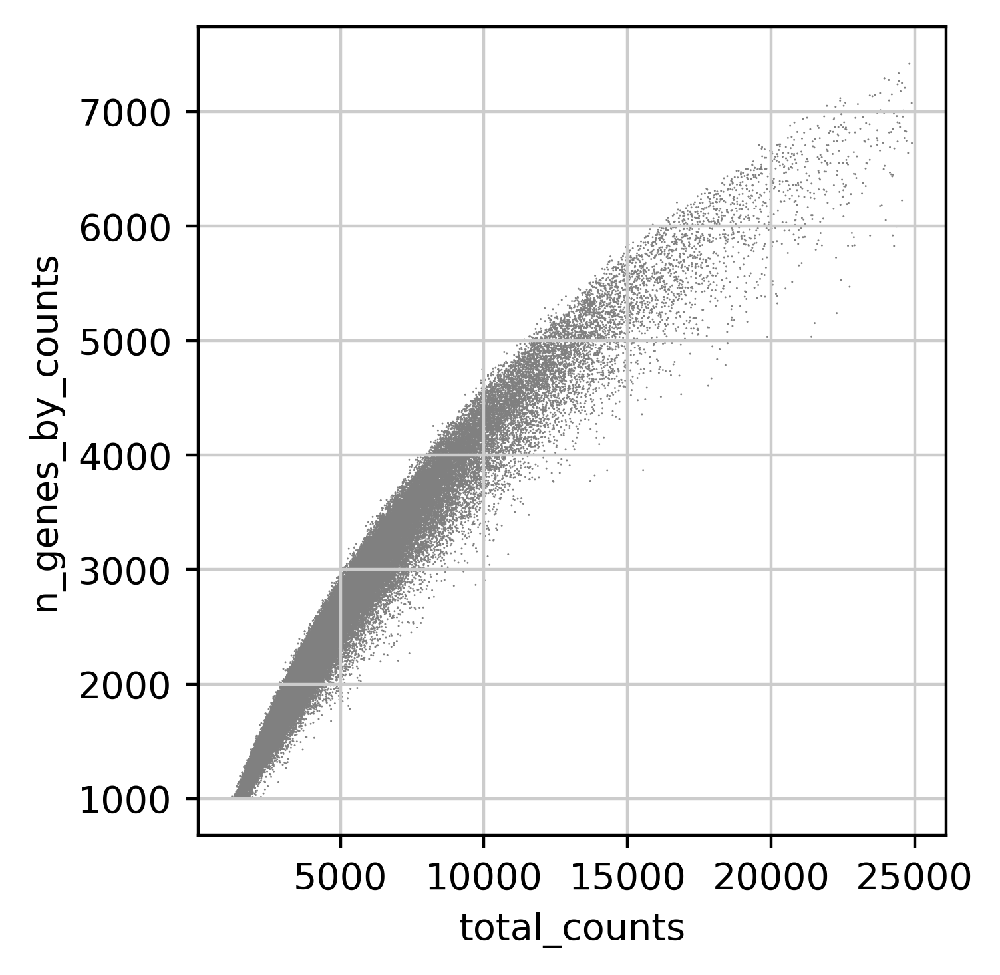

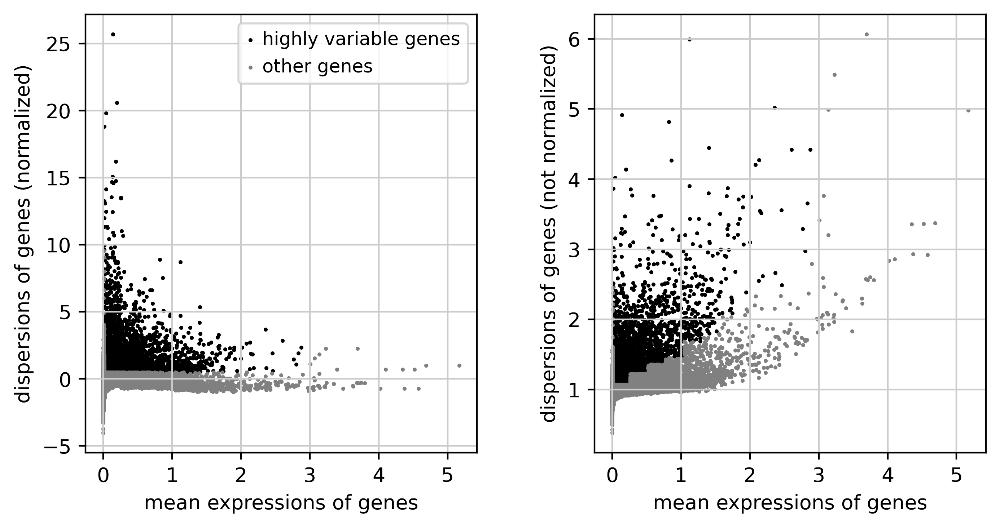

In [146]:
sc.set_figure_params(
    figsize=(4,4),
    dpi=200,
    fontsize=10
)

sc.pl.scatter(adata, x='total_counts', y='pct_counts_mito')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
sc.pl.highly_variable_genes(adata)

In [147]:
## Finish preprocessing w/ PCA
sc.pp.scale(
    adata, 
    max_value=10
)
sc.tl.pca(
    adata, 
    svd_solver='arpack',
    n_comps=50
)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:47)


In [148]:
# Cell cycle state inference

#load in cell cycle genes lists
s_genes = list(pd.read_csv("resources/seurat_s_genes_2019.csv")['x'])
g2m_genes = list(pd.read_csv("resources/seurat_g2m_genes_2019.csv")['x'])

# score and plot
sc.tl.score_genes_cell_cycle(
    adata, 
    s_genes=s_genes, 
    g2m_genes=g2m_genes, 
    use_raw=False
)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    344 total control genes are used. (0:00:56)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    471 total control genes are used. (0:00:53)
-->     'phase', cell cycle phase (adata.obs)


In [149]:
# Harmony integration
sce.pp.harmony_integrate(
    adata=adata, 
    key=["sample","phase"], 
    basis='X_pca',
    adjusted_basis='X_pca_harmony'
)

2021-10-26 12:36:06,164 - harmonypy - INFO - Iteration 1 of 10
2021-10-26 12:38:02,291 - harmonypy - INFO - Iteration 2 of 10
2021-10-26 12:39:59,106 - harmonypy - INFO - Iteration 3 of 10
2021-10-26 12:41:58,909 - harmonypy - INFO - Converged after 3 iterations


In [ ]:
### Clustering (test multiple resolutions)

In [150]:

sc.pp.neighbors(
    adata,
    n_neighbors=50,
    n_pcs=50,
    use_rep="X_pca_harmony"
)

sc.tl.leiden(
    adata,
    resolution=0.8,
    key_added='leiden_harmony_08'
)

gc.collect()

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:46)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden_harmony', the cluster labels (adata.obs, categorical) (0:03:02)


In [ ]:
sc.tl.leiden(
    adata,
    resolution=1.0,
    key_added='leiden_harmony_10'
)
gc.collect()

In [ ]:
sc.tl.leiden(
    adata,
    resolution=1.2,
    key_added='leiden_harmony_12'
)
gc.collect()

In [ ]:
sc.tl.leiden(
    adata,
    resolution=1.5,
    key_added='leiden_harmony_15'
)
gc.collect()

In [151]:
sc.tl.umap(
    adata,
    neighbors_key ="neighbors"
)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:12)


In [27]:
gc.collect()

0

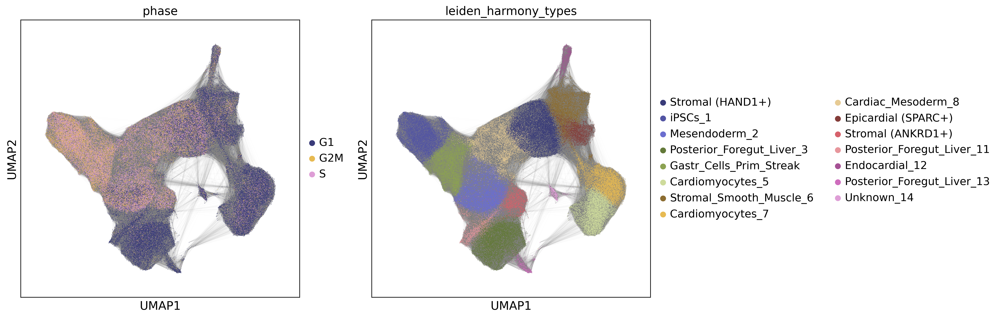

In [32]:
sc.set_figure_params(
    figsize=(6,6),
    dpi=200
)
sc.pl.umap(
    adata_new, 
#     color=['sample', 'phase','timepoint','leiden_harmony'],
    color=['phase','leiden_harmony_types'],
    edges=True, edges_width=0.01,
    use_raw=False,
    ncols=2    
)

## PHATE

In [225]:
# PHATE reduction of Harmony embedding
# https://nbviewer.jupyter.org/github/KrishnaswamyLab/PHATE/blob/master/Python/tutorial/EmbryoidBody.ipynb
import phate
phate_operator = phate.PHATE(
    knn=50,
    decay=40,
    t='auto',
    mds_solver='smacof',
    n_jobs=24
)

# Use top N harmony dims
n_dims=50
tmp_phate = phate_operator.fit_transform(adata.obsm["X_pca_harmony"][:,:n_dims]) 
adata.obsm['X_phate_harmony'] = tmp_phate

Calculating PHATE...
  Running PHATE on 106488 observations and 50 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 791.78 seconds.
    Calculating affinities...
    Calculated affinities in 10.70 seconds.
  Calculated graph and diffusion operator in 807.04 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 134.20 seconds.
    Calculating KMeans...
    Calculated KMeans in 61.98 seconds.
  Calculated landmark operator in 204.36 seconds.
  Calculating optimal t...
    Automatically selected t = 20
  Calculated optimal t in 8.19 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 3.00 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 11.62 seconds.
Calculated PHATE in 1034.29 seconds.


In [32]:
sc.set_figure_params(
    figsize=(4,4),
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color='leiden_harmony',#['sample','leiden_harmony', 'phase', "time_int"],
    edges=True, edges_width=0.005,
    palette='tab20b',
    legend_loc='on data',
    legend_fontsize=8,
#      add_outline=True,
    size=3,
    sort_order=False,
    ncols=2
)

NameError: name 'adata' is not defined

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


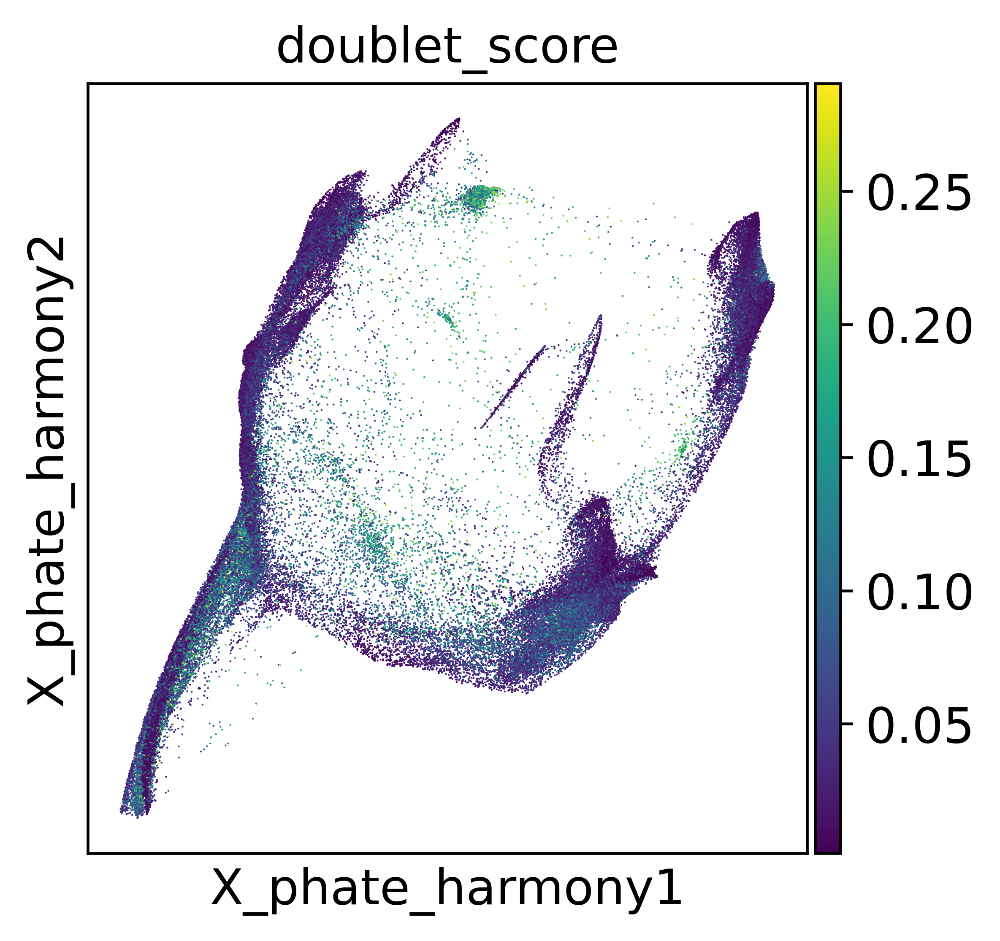

In [248]:
sc.set_figure_params(figsize=(4,4),dpi=300)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=[ "doublet_score"], #'EPCAM','KDR', 'PECAM1',
    color_map='viridis',
    
    ncols=2,
    sort_order=False
)

computing density on 'phate_harmony'
--> added
    'phate_harmony_density_timepoint', densities (adata.obs)
    'phate_harmony_density_timepoint_params', parameter (adata.uns)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


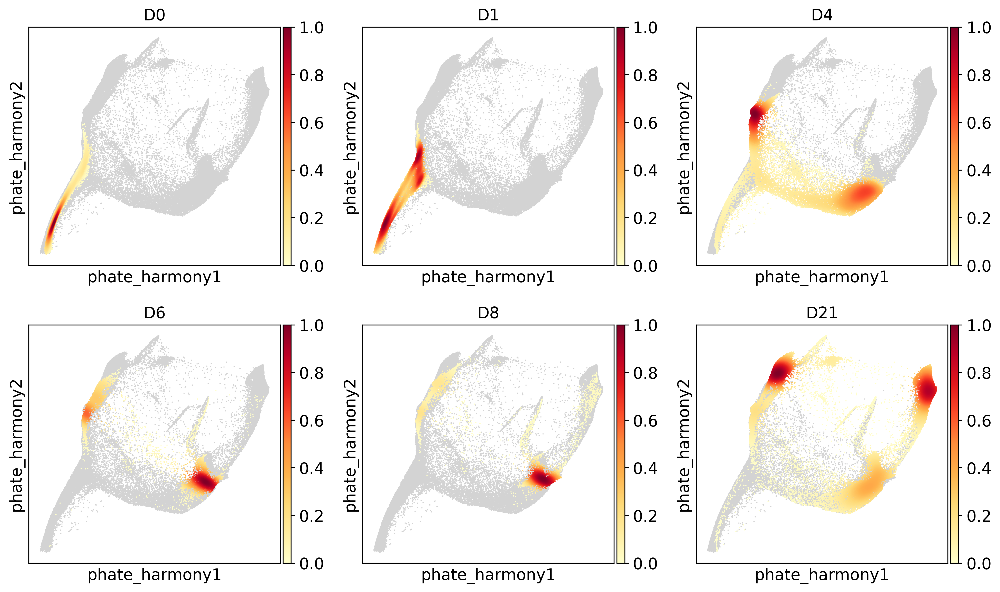

In [228]:
# Compute/plot density across the PHATE embedding
# https://scanpy.readthedocs.io/en/stable/generated/scanpy.tl.embedding_density.html
sc.set_figure_params(figsize=(4,4),dpi=200)

sc.tl.embedding_density(
    adata,
    basis='phate_harmony', 
    groupby='timepoint'
)
sc.pl.embedding_density(
    adata,
    basis='phate_harmony',
    key='phate_harmony_density_timepoint', 
    bg_dotsize=5,
    fg_dotsize=5,
    ncols=3,
    group=['D0','D1','D4','D6','D8','D21']
)

## Filter out putative noisy cells/doublets

In [230]:
# Filter out cluster enriched with doublets
adata_new = adata[~adata.obs['leiden_harmony'].isin(['9']),:]

In [231]:
#  Re-compute nn graph and clustering
sc.pp.neighbors(
    adata_new,
    n_neighbors=50,
    n_pcs=50,
    use_rep="X_pca_harmony"
)

sc.tl.leiden(
    adata_new,
    resolution=0.8,
    key_added='leiden_harmony_08'
)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:02)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden_harmony', the cluster labels (adata.obs, categorical) (0:05:14)


In [14]:
sc.tl.leiden(
    adata_new,
    resolution=1.0,
    key_added='leiden_harmony_10'
)

running Leiden clustering
    finished: found 15 clusters and added
    'leiden_harmony_10', the cluster labels (adata.obs, categorical) (0:02:15)


In [15]:
sc.tl.leiden(
    adata_new,
    resolution=1.2,
    key_added='leiden_harmony_12'
)

running Leiden clustering
    finished: found 19 clusters and added
    'leiden_harmony_12', the cluster labels (adata.obs, categorical) (0:01:47)


In [16]:
sc.tl.leiden(
    adata_new,
    resolution=1.5,
    key_added='leiden_harmony_15'
)

running Leiden clustering
    finished: found 24 clusters and added
    'leiden_harmony_15', the cluster labels (adata.obs, categorical) (0:02:51)


In [71]:
adata_new.obs['leiden_harmony_types']

AAACCCAAGTGCAACG                      iPSCs_1
AAACCCAAGTTGGAGC                      iPSCs_1
AAACCCACATACCAGT                      iPSCs_1
AAACCCACATAGAGGC                      iPSCs_1
AAACCCAGTGCAACAG                      iPSCs_1
                              ...            
TTTGTTGTCAGACCTA             Cardiomyocytes_5
TTTGTTGTCCAGTGTA    Posterior_Foregut_Liver_3
TTTGTTGTCGTGCTCT    Posterior_Foregut_Liver_3
TTTGTTGTCTACTGAG    Posterior_Foregut_Liver_3
TTTGTTGTCTGGACCG    Posterior_Foregut_Liver_3
Name: leiden_harmony_types, Length: 105020, dtype: category
Categories (15, object): ['Stromal (HAND1+)', 'iPSCs_1', 'Mesendoderm_2', 'Posterior_Foregut_Liver_3', ..., 'Posterior_Foregut_Liver_11', 'Endocardial_12', 'Posterior_Foregut_Liver_13', 'Unknown_14']

In [8]:
adata_new.obs_keys


<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 105020 × 31146
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'sample', 'data.dir', 'patterm', 'pattern_int', 'timepoint', 'time_int', 'doublet_score', 'predicted_doublet', 'batch', 'S_score', 'G2M_score', 'phase', 'leiden_harmony', 'phate_harmony_density_timepoint', 'leiden_harmony_10', 'leiden_harmony_12', 'leiden_harmony_15', 'leiden_harmony_types'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-10', 'n_cells_by_counts-10', 'mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_c

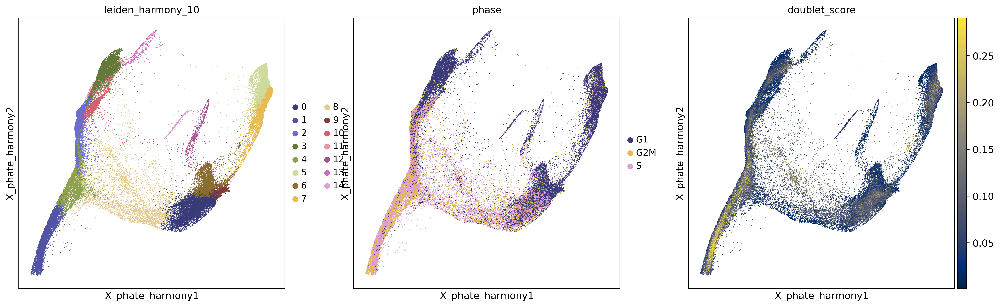

In [187]:
sc.set_figure_params(
    figsize=(6,6),
    fontsize=12,
    transparent=True,
    dpi=200
)
sc.pl.embedding(
    adata_new,
    basis='X_phate_harmony',
    color=['leiden_harmony_10','phase', 'doublet_score'],
#     color=['leiden_harmony','leiden_harmony_10', 'leiden_harmony_12', 'leiden_harmony_15'],
#     color = ['APOA1','KDR', 'FAM184A','CDH2'],
#     color = ['GATA2','GATA3', 'GATA4','GATA6'],
#     color=['pattern_timepoint'],
#     edges=True, edges_width=0.01, 
#     edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=3,
    sort_order=True,
#     return_fig=True,
    ncols=3
)

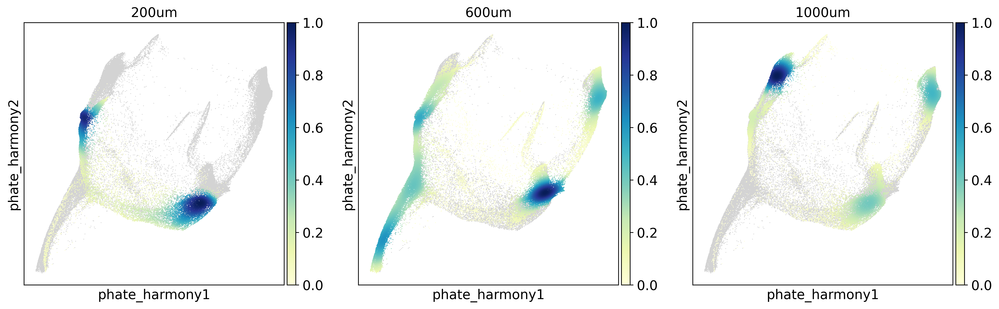

In [145]:
sc.set_figure_params(
    figsize=(5,5),
    dpi=200
)

# sc.tl.embedding_density(
#     adata_new,
#     basis='phate_harmony', 
#     groupby='patterm'
# )
sc.pl.embedding_density(
    adata_new,
    basis='phate_harmony',
    key='phate_harmony_density_patterm', 
    bg_dotsize=3,
    fg_dotsize=3,
    ncols=3,
    color_map="YlGnBu",
    group=['200um','600um','1000um']
)

In [288]:
# import pandas as pd
tmp = np.core.defchararray.add(
        list(adata_new.obs['patterm']),
        list(adata_new.obs['timepoint'])
    )

for x in ['600umD0', '600umD1', '600umD12', '600umD6', '600umD8']:
    tmp[tmp==x] = "other"
    
print(np.unique(tmp))

adata_new.obs['pattern_timepoint'] = tmp

['1000umD21' '1000umD4' '200umD21' '200umD4' '600umD21' '600umD4' 'other']


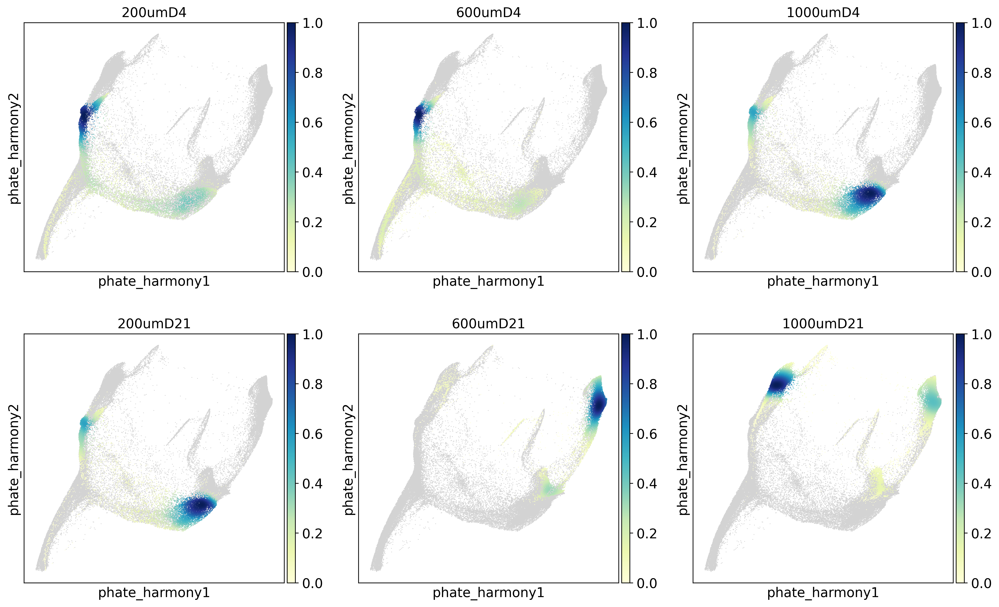

In [291]:
sc.set_figure_params(
    figsize=(5,5),
    dpi=200
)

# sc.tl.embedding_density(
#     adata_new,
#     basis='phate_harmony',
#     groupby='pattern_timepoint'
# )

sc.pl.embedding_density(
    adata_new,
    basis='phate_harmony',
    key='phate_harmony_density_pattern_timepoint', 
    bg_dotsize=3,
    fg_dotsize=3,
    ncols=3,
    color_map="YlGnBu",
    group=['200umD4','600umD4','1000umD4','200umD21','600umD21','1000umD21']
)

In [269]:
# Subset D4 cells
# d4_adata = adata_new[~adata_new.obs['timepoint'].isin(['D4']),:]
d4_adata = adata_new[adata_new.obs['timepoint']=='D4',:]

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


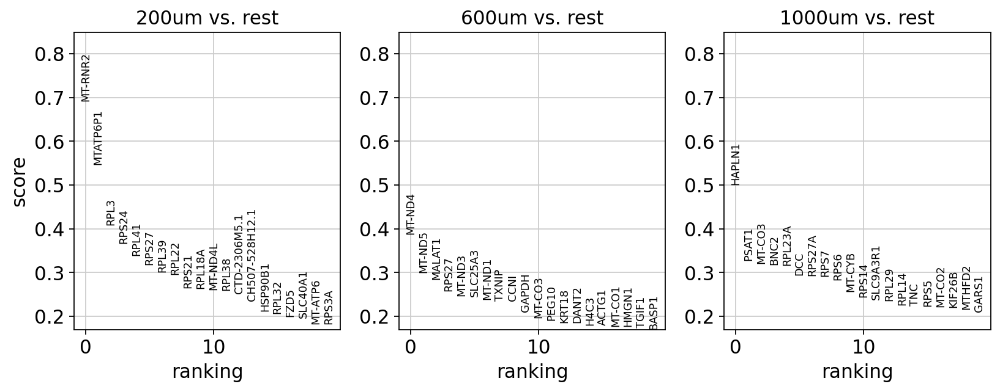

In [302]:
# Run DGEA across spot sizes
sc.tl.rank_genes_groups(
    d4_adata,
    'patterm',
    method='logreg' #wilcoxon
)

# visualize the results
sc.pl.rank_genes_groups(
    d4_adata,
    n_gene=30,
    ncols=5
)

In [116]:
d4_genes = {
    '200um':['STEAP1B','HAS2','DSCAM','BMPER','PRTG','COLEC12','SERPINE2','HAS2','HAPLN2'],
    '600um':['MT-RNR2','MT-ND1','NPM1','TKT','MYH6','MTATP6P1'],
    '1000um':['AFP','TTR','CDH2','MGST3','SPINK1','AMBP','MAGI1']
}

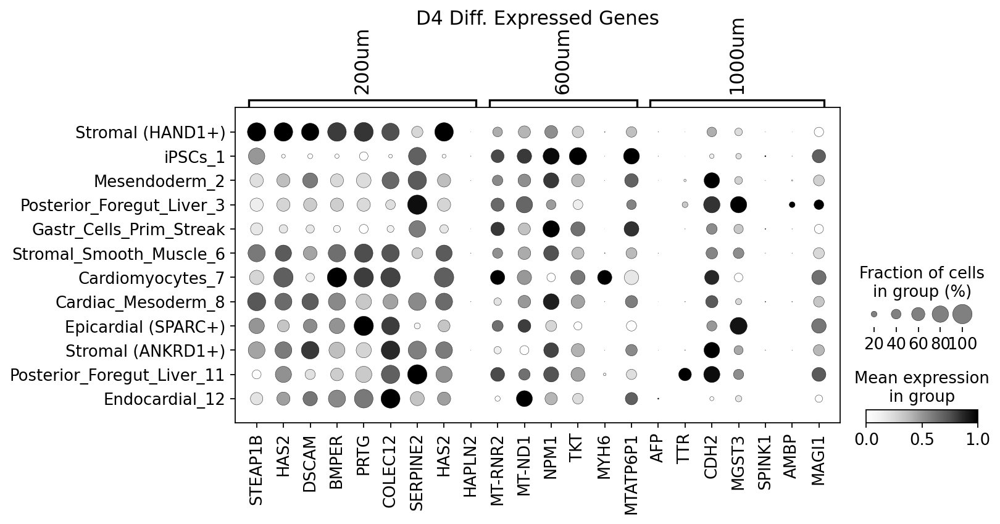

In [298]:
sc.set_figure_params(
#     figsize=(6,6),
    transparent=True
)

sc.pl.dotplot(
    d4_adata,
    var_names=d4_genes,
    groupby='leiden_harmony_types', 
#     layer="counts",
#     color_map="viridis",
    title="D4 Diff. Expressed Genes",
    color_map='Greys',
    use_raw=False,
    standard_scale ='var',
#     swap_axes=True,
    dendrogram=False
)

In [299]:
gc.collect()

104

#### D21 DGEA

In [267]:
# Subset D21 cells
# d21_adata = adata_new[~adata_new.obs['timepoint'].isin(['D21']),:]
d21_adata = adata_new[adata_new.obs['timepoint']=='D21',:]

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


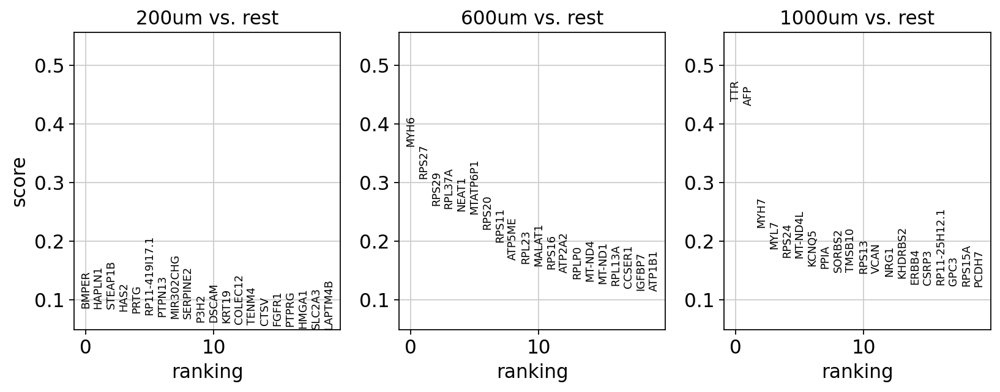

In [301]:
# Run DGEA across spot sizes

sc.tl.rank_genes_groups(
    d21_adata,
    'patterm',
    method='logreg' #wilcoxon
)

# visualize the results
sc.pl.rank_genes_groups(
    d21_adata,
    n_gene=30,
    ncols=5
)

In [119]:
d21_genes = {
    '200um':['STEAP1B','LINC00458','SERPINE2','HAS2','DSCAM','FBN2','MIR302CHG','SFRP1','HAPLN2'],
    '600um':['GAPDH','SLC25A3','MT-ND4','MT-ND5','FTL','CKB','TPI1'],
    '1000um':['STEAP1B','HAS2','PRTG','DSCAM','HAPLN1','BMPER','CGNL1','TEAD1']
}

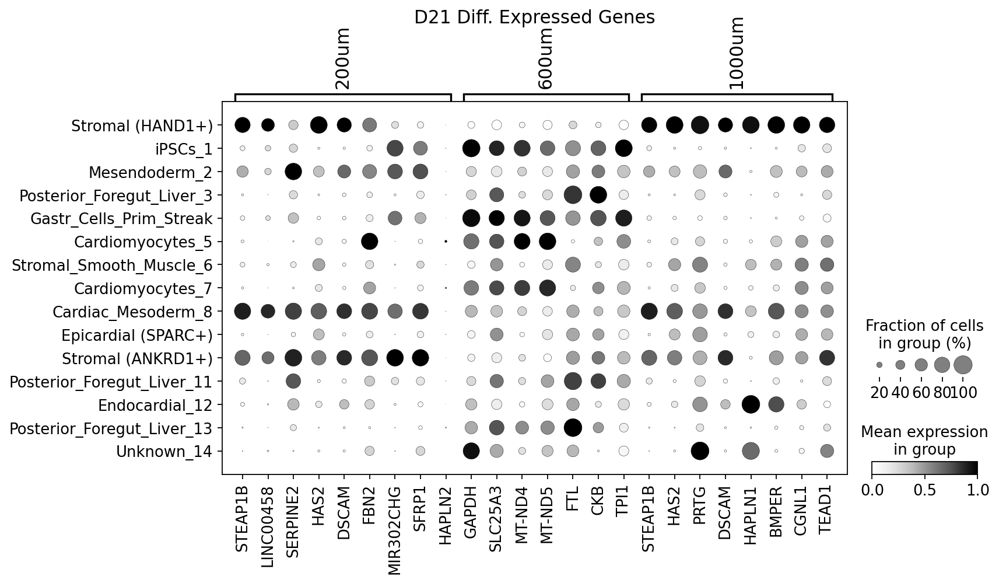

In [121]:
sc.set_figure_params(
#     figsize=(6,6),
    transparent=True
)

sc.pl.dotplot(
    d21_adata,
    var_names=d21_genes,
    groupby='leiden_harmony_types', 
#     layer="counts",
#     color_map="viridis",
    title="D21 Diff. Expressed Genes",
    color_map='Greys',
    use_raw=False,
    standard_scale ='var',
#     swap_axes=True,
    dendrogram=False
)

### 3D PHATE

In [235]:
phate_operator = phate.PHATE(
    knn=40,
    decay=40,
    t='auto',
    mds_solver='smacof',
    n_components=3,
    n_jobs=30
)

tmp_phate = phate_operator.fit_transform(adata_new.obsm["X_pca_harmony"][:,:50]) 
adata_new.obsm['X_phate_harmony_3D'] = tmp_phate


Calculating PHATE...
  Running PHATE on 105020 observations and 50 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 741.60 seconds.
    Calculating affinities...
    Calculated affinities in 10.19 seconds.
  Calculated graph and diffusion operator in 755.80 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 113.84 seconds.
    Calculating KMeans...
    Calculated KMeans in 70.23 seconds.
  Calculated landmark operator in 191.43 seconds.
  Calculating optimal t...
    Automatically selected t = 19
  Calculated optimal t in 7.78 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 3.51 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 35.51 seconds.
Calculated PHATE in 994.09 seconds.


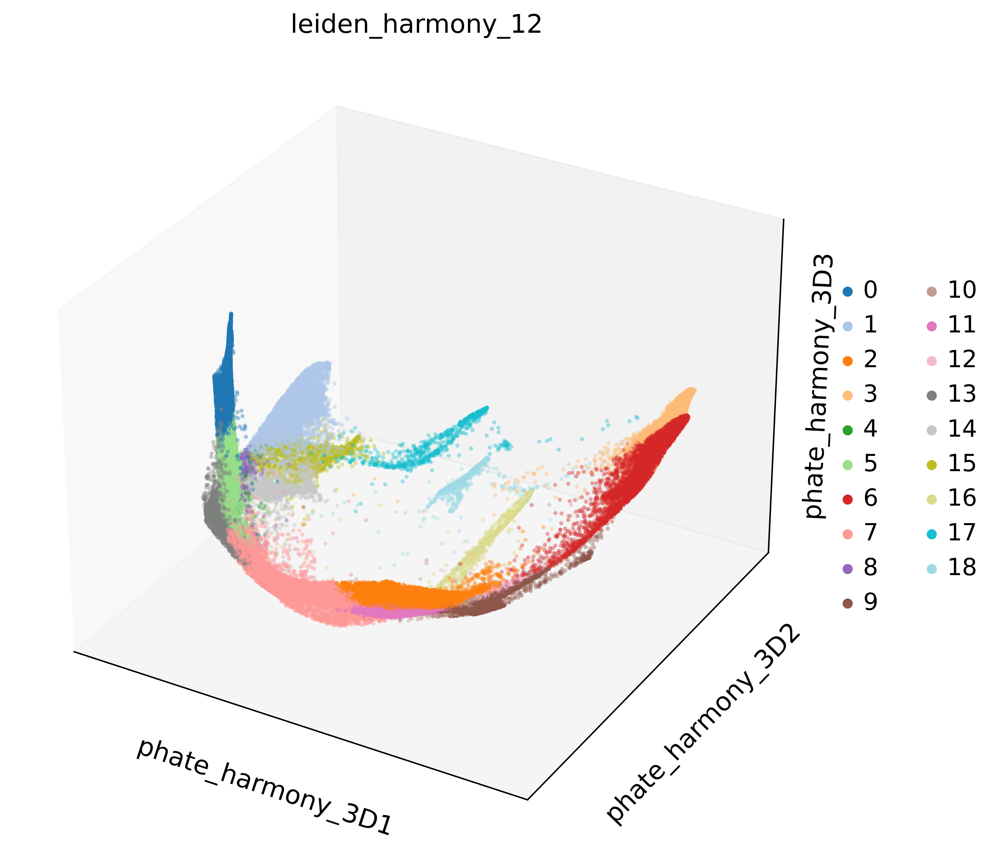

In [19]:
sc.set_figure_params(figsize=(8,8),dpi=300)
sc.pl.embedding(
    adata_new,
    basis='phate_harmony_3D',
    projection='3d',
    color=["leiden_harmony_12"], #,"doublet_score"
    size=5,
    alpha=0.4,
    ncols=2,
#     color_map='viridis',
    sort_order=False
)

## Save preprocessed object for future analyses (python & R)

In [237]:
# Make sure that time points are saved as a continuous variable, not a categorical variable
adata_new.obs["time_int"] = adata_new.obs["time_int"].astype("float")

In [85]:
# Save h5ad object for subsequent python analyses
# adata_new.write("pyobjs/ma_iPSC_v2.h5ad")

# Save Seurat compatible object for subsequent R analyses
#TODO
# https://mojaveazure.github.io/seurat-disk/articles/convert-anndata.html

In [227]:
adata_new = sc.read_h5ad(
    filename="/workdir/dwm269/ma_ipsc/pyobjs/ma_iPSC_v2.h5ad"
)